In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity
from sentence_transformers import SentenceTransformer   
import textwrap
import seaborn as sns
import preamble
import torch
import src.constants as const

In [2]:
MODEL_NAME = "google/embeddinggemma-300m" # previously chosen embedding model
OUTDATED_MODELS = ["jinaai/jina-embeddings-v3",
            "jinaai/jina-embeddings-v4",
            "Snowflake/snowflake-arctic-embed-l-v2.0",
            "BAAI/bge-m3", 
            'sentence-transformers/all-MiniLM-L6-v2', 
            'sentence-transformers/all-mpnet-base-v2',
            'Qwen/Qwen3-Embedding-0.6B']

In [3]:
# import dataframe of migration speeches with embeddings
df = pd.read_parquet("data/speech_embeddings.parquet")

In [4]:
# delete all columns of outdated models to save memory
for outdated_model in OUTDATED_MODELS:
    if outdated_model in df.columns:
        del df[outdated_model]

In [5]:
# inspect the dataframe
df.head()

,Unnamed: 0,speaker,text,date,agenda,speechnumber,procedure_ID,partyfacts_ID,period,chair,...,written,multispeaker,link,translatedText,translationSource,year,block,party,migration_prob,google/embeddinggemma-300m
492,492,Karen Melchior,"Mr President, thank you very much to the Commi...",2024-04-24,22. Advance passenger information: enhancing a...,8,bill_26075_ID bill_26076_ID bill_26075_ID bi...,6401.0,9,False,...,False,False,https://www.europarl.europa.eu/doceo/document/...,"Mr President, thank you very much to the Commi...",original_gm,2024,liberal,ELDR/ALDE/Renew,0.393282,"[-0.06368264, -0.01790871, 0.008169121, 0.0173..."
844,844,Tineke Strik,"Mr President, Commissioner. People who flee wa...",2024-04-23,17. EU-Egypt strategic and comprehensive partn...,9,,6403.0,9,False,...,False,False,https://www.europarl.europa.eu/doceo/document/...,"Mr President, Commissioner. People who flee wa...",original_gm,2024,green,Greens/EFA,0.423501,"[-0.06358229, 0.05332363, -0.006831329, 0.0041..."
1050,1050,Anabela Rodrigues,"Senhora Presidente, em 2024, o tráfico de sere...",2024-04-22,20. Amending Directive 2011/36/EU on preventin...,10,bill_241_ID bill_241_ID,6402.0,9,False,...,False,False,https://www.europarl.europa.eu/doceo/document/...,"Madam President, in 2024, human trafficking co...",machine_gm,2024,left,NGL/The Left,0.375925,"[-0.049918693, -0.001202861, -0.008896867, -0...."
1054,1054,Beata Kempa,Pani Przewodnicząca! Pani Komisarz! Potrzebuje...,2024-04-22,20. Amending Directive 2011/36/EU on preventin...,14,bill_241_ID bill_241_ID,6400.0,9,False,...,False,False,https://www.europarl.europa.eu/doceo/document/...,"Madam Commissioner! We need very specific, ver...",machine_gm,2024,(extreme)_right,ECR,0.256493,"[-0.035047594, 0.03835739, -0.051198084, 0.050..."
1056,1056,Dorien Rookmaker,"Voorzitter, dank u wel, meneer Engerer, want u...",2024-04-22,20. Amending Directive 2011/36/EU on preventin...,16,bill_241_ID bill_241_ID,6400.0,9,False,...,False,False,https://www.europarl.europa.eu/doceo/document/...,"Madam President, thank you, Mr Engerer, becaus...",machine_gm,2024,(extreme)_right,ECR,0.475315,"[-0.06766452, 0.015919995, -0.019874139, -0.01..."


In [6]:
# load the google embedding model
device = "cuda" if torch.cuda.is_available() else "mps" if torch.mps.is_available() else "cpu" 
model = SentenceTransformer(MODEL_NAME, trust_remote_code=True).to(device)

In [7]:
# hard-code migration narratives identified in Seiger et al., 2025 (Report from Joint Research Centre of the European Commission)
queries_jrc = {
    "anti_immigration" : 
    ["Immigrants’ identity or culture is problematic",
    "Immigration is a threat to the European way of life and identity",
    "Arabs and Muslims are a cultural or social threat",
    "Certain immigrants are unwilling or incapable to integrate",
    "Immigration is a threat to individual safety",
    "Immigration is a threat to national security",
    "Immigrants are prone to committing crimes (violent, non-violent, organised, sexual)",
    "Many immigrants are terrorists",
    "Immigrants spread diseases",
    "There are too many immigrants coming",
    "Immigrants do not contribute to the economy",
    "Immigrants take our jobs",
    "Many asylum seekers are actually economic migrants",
    "Immigrants abuse the welfare system",
    "Immigrants are a strain on our health-care system",
    "Immigrants are a strain on the housing market",
    "Immigration reduces the attractiveness of location and lowers overall life quality",
    "Receiving immigrants is too expensive/ immigration burdens tax payers"
    ],
    "immigrants_are_victims": 
    ["Immigrants are victims of human traffickers",
    "Certain immigrants or asylum seekers are discriminated against",
    "EU is in breach of international law",
    "Immigrants suffer from labour exploitation"
    ],
    "populist/anti-elitist": 
    ["EU is harmful for our nation",
    "Let’s overthrow the establishment",
    "Political rivals act against the interests of the people",
    "Our sovereignty is under threat"
    ]
}
queries_jrc_flat = [query for category_queries in queries_jrc.values() for query in category_queries]  

In [9]:
# embed jrc queries
query_embeddings = model.encode(queries_jrc_flat, batch_size=32, normalize_embeddings=True, prompt_name="Retrieval-query")

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [10]:
# compute cosine similarity between query embeddings and speech embeddings for every speech
for i, query_embedding in enumerate(query_embeddings):
    column_name = queries_jrc_flat[i]
    df[column_name] = df[MODEL_NAME].apply(lambda x: cosine_similarity([query_embedding], [x])[0][0])

In [11]:
def top_speeches(df, query, n=5):
    '''Prints the top n speeches that have the highest cosine similarity to the query'''
    if query not in df.columns:
        print(f"Query '{query}' not found in dataframe columns, computing embedding..." )
        query_embedding = model.encode_query([query], batch_size=1)[0]
        df[query] = df[MODEL_NAME].apply(lambda x: cosine_similarity([query_embedding], [x])[0][0])
    top = df.nlargest(n, query)
    print(f"Top {n} speeches for query: '{query}'")
    for _, row in top.iterrows():
        print(f"{row['speaker']}  (sim={row[query]:.4f})")
        print(textwrap.fill(row['translatedText'], width=90))
        print()
    print("--------------------------------------------------\n")

In [13]:
for query in queries_jrc_flat:
    top_speeches(df, query, n=5)

Top 5 speeches for query: 'Immigrants’ identity or culture is problematic'
Josep-Maria Terricabras  (sim=0.4609)
I do not think these are new challenges. These are also very old challenges, because the
problem of immigration is a very old problem in Europe. We have to solve these problems in
a different way, in a new way.

Kristina Winberg  (sim=0.4550)
Yes, I absolutely agree with this. They have the same language, they have the same
culture, they have the same way of life. Why don't they open up? No, they buy themselves
free. They must take greater responsibility. We in the EU cannot take this large amount of
migrants. We are cracking, we will not be able to function if we are going to continue to
have open borders. I certainly think they can take on a much greater responsibility.

Therese Comodini Cachia  (sim=0.4497)
Significant differences still exist in the modalities of processing requests for
international protection in Member States. This report indicates that slow and excessi

In [ ]:
# aggregate over parties and years in case we want to inspect mean similarities
agg = (
    df
    .groupby(["block", "year"])
    .agg({q: "mean" for q in queries_jrc_flat})
    .reset_index()
)

# add number of speeches per group (not currently used, but potentially relevant)
counts = df.groupby(["block", "year"]).size().reset_index(name="n_speeches")
agg = agg.merge(counts, on=["block", "year"])

## Plot cosine similarities for every party over time

In [14]:
def mean_similarity_plots(ax, df, query):
    if query not in df.columns:
        print(f"Query '{query}' not found in dataframe columns, computing embedding..." )
        query_embedding = model.encode_query([query], batch_size=1)[0]
        df[query] = df[MODEL_NAME].apply(lambda x: cosine_similarity([query_embedding], [x])[0][0])
    sns.lineplot(data=df, x='year', y=query, hue='block', marker='o', palette=const.COLOR_MAP_BLOCK, ax=ax, errorbar='ci')
    ax.set_title(query[:60] + ("..." if len(query) > 60 else ""))
    ax.set_ylabel("Mean Cosine Similarity")
    ax.set_xlabel("Year")
    # ax.legend(title='Party Block')
    ax.grid(True)

In [15]:
queries = queries_jrc_flat
fig, axes = plt.subplots(len(queries)//2, 2, figsize=(12, 4 * len(queries)//2))
for ax, query in zip(axes.flatten(), queries):
    mean_similarity_plots(ax, df, query)
    # on first pass, set legend
    if ax == axes.flatten()[0]:
        ax.legend(title='Party Block')

plt.tight_layout()
plt.show()

findfont: Generic family 'sans-serif' not found because none of the following families were found: Roboto Condensed
findfont: Generic family 'sans-serif' not found because none of the following families were found: Roboto Condensed
findfont: Generic family 'sans-serif' not found because none of the following families were found: Roboto Condensed
findfont: Generic family 'sans-serif' not found because none of the following families were found: Roboto Condensed
findfont: Generic family 'sans-serif' not found because none of the following families were found: Roboto Condensed
findfont: Generic family 'sans-serif' not found because none of the following families were found: Roboto Condensed
findfont: Generic family 'sans-serif' not found because none of the following families were found: Roboto Condensed
findfont: Generic family 'sans-serif' not found because none of the following families were found: Roboto Condensed
findfont: Generic family 'sans-serif' not found because none of the foll

findfont: Generic family 'sans-serif' not found because none of the following families were found: Roboto Condensed
findfont: Generic family 'sans-serif' not found because none of the following families were found: Roboto Condensed
findfont: Generic family 'sans-serif' not found because none of the following families were found: Roboto Condensed
findfont: Generic family 'sans-serif' not found because none of the following families were found: Roboto Condensed
findfont: Generic family 'sans-serif' not found because none of the following families were found: Roboto Condensed
findfont: Generic family 'sans-serif' not found because none of the following families were found: Roboto Condensed
findfont: Generic family 'sans-serif' not found because none of the following families were found: Roboto Condensed
findfont: Generic family 'sans-serif' not found because none of the following families were found: Roboto Condensed
findfont: Generic family 'sans-serif' not found because none of the foll

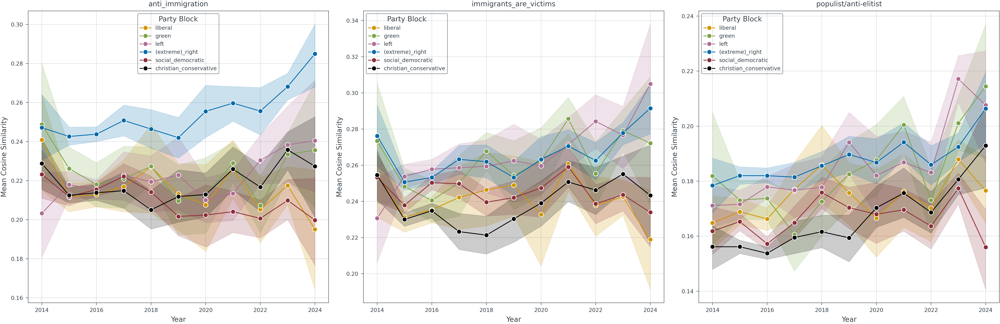

In [20]:
# compute average similarity for each category
for category, category_queries in queries_jrc.items():
    df[category] = df[category_queries].mean(axis=1)

# plot
fig, axes = plt.subplots(1, 3, figsize=(18, 6))
for ax, category in zip(axes, queries_jrc.keys()):
    mean_similarity_plots(ax, df, category)
    ax.legend(title='Party Block')

plt.tight_layout()
plt.show()

### Test: Pro - anti contrast axes

In [18]:
anti_immigration_axis = {
    "pro": [
        "Immigration is bad",
        "Immigrants’ identity or culture is problematic",
        "Immigration is a threat to the European way of life and identity",
        "Arabs and Muslims are a cultural or social threat",
        "Certain immigrants are unwilling or incapable to integrate",
        "Immigration is a threat to individual safety",
        "Immigration is a threat to national security",
        "Immigrants are prone to committing crimes (violent, non-violent, organised, sexual)",
        "Many immigrants are terrorists",
        "Immigrants spread diseases",
        "There are too many immigrants coming",
        "Immigrants do not contribute to the economy",
        "Immigrants take our jobs",
        "Many asylum seekers are actually economic migrants",
        "Immigrants abuse the welfare system",
        "Immigrants are a strain on our health-care system",
        "Immigrants are a strain on the housing market",
        "Immigration reduces the attractiveness of location and lowers overall life quality",
        "Receiving immigrants is too expensive/ immigration burdens tax payers"
    ],
    "anti": [
        "Immigration is not bad",
        "Immigrants’ identity or culture is not problematic",
        "Immigration is not a threat to the European way of life and identity",
        "Arabs and Muslims are not a cultural or social threat",
        "Most immigrants are willing and able to integrate",
        "Immigration is not a threat to individual safety",
        "Immigration is not a threat to national security",
        "Immigrants are not more prone to committing crimes than others",
        "Immigrants are not terrorists",
        "Immigrants do not spread diseases",
        "The number of immigrants is manageable",
        "Immigrants contribute to the economy",
        "Immigrants do not take jobs from others",
        "Most asylum seekers are genuine refugees",
        "Immigrants do not abuse the welfare system",
        "Immigrants are not a strain on the health-care system",
        "Immigrants are not a strain on the housing market",
        "Immigration does not reduce quality of life",
        "Receiving immigrants is not too expensive and does not overly burden taxpayers"
    ]
}


In [19]:
pro_texts = anti_immigration_axis["pro"]
anti_texts = anti_immigration_axis["anti"] 
axes = {}

for i, (pro, anti) in enumerate(zip(pro_texts, anti_texts)):
    pro_emb = model.encode_query(pro, normalize_embeddings=True)
    anti_emb = model.encode_query(anti, normalize_embeddings=True)

    axis = pro_emb - anti_emb
    axis /= np.linalg.norm(axis)

    axes[i] = {
        "pro": pro,
        "anti": anti,
        "axis": axis
    }

In [20]:
speech_embeddings = np.vstack(df[MODEL_NAME].values)
for i, axis in enumerate(axes.values()):
    column_name = pro_texts[i]
    df[column_name] = np.array([emb @ axis["axis"] for emb in speech_embeddings])

In [8]:
# pro_embeddings = model.encode_query(anti_immigration_axis["pro"], batch_size=32)
# anti_embeddings = model.encode_query(anti_immigration_axis["anti"], batch_size=32)
# axis = np.mean(pro_embeddings, axis=0) - np.mean(anti_embeddings, axis=0)
# axis = axis / np.linalg.norm(axis)  # unit length

# # for every embedding, compute its axis
# for embedding 
# axis = np.mean(pro_embeddings, axis=0) - np.mean(anti_embeddings, axis=0)
# axis = axis / np.linalg.norm(axis)  # unit length

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [21]:
queries = pro_texts
fig, axes = plt.subplots(len(queries)//2, 2, figsize=(12, 4 * len(queries)//2))
for ax, query in zip(axes.flatten(), queries):
    mean_similarity_plots(ax, df, query)
    # on first pass, set legend
    if ax == axes.flatten()[0]:
        ax.legend(title='Party Block')

plt.tight_layout()
plt.show()

findfont: Generic family 'sans-serif' not found because none of the following families were found: Roboto Condensed
findfont: Generic family 'sans-serif' not found because none of the following families were found: Roboto Condensed
findfont: Generic family 'sans-serif' not found because none of the following families were found: Roboto Condensed
findfont: Generic family 'sans-serif' not found because none of the following families were found: Roboto Condensed
findfont: Generic family 'sans-serif' not found because none of the following families were found: Roboto Condensed
findfont: Generic family 'sans-serif' not found because none of the following families were found: Roboto Condensed
findfont: Generic family 'sans-serif' not found because none of the following families were found: Roboto Condensed
findfont: Generic family 'sans-serif' not found because none of the following families were found: Roboto Condensed
findfont: Generic family 'sans-serif' not found because none of the foll